This notebook demonstrates our graph network inductive bias with a symbolic model extraction.

# Preamble and data generation

## Make sure to turn on the GPU via Edit-> Notebook settings.

In [5]:
#Basic pre-reqs:
import numpy as np
import os
import torch
from torch.autograd import Variable
from matplotlib import pyplot as plt
%matplotlib inline

## Download pre-reqs, and then code for simulations and model files:

(Note: installing torch-geometric may take a long time.)

In [2]:
!pip install celluloid

In [3]:
version_nums = torch.__version__.split('.')
# Torch Geometric seems to always build for *.*.0 of torch :
version_nums[-1] = '0' + version_nums[-1][1:]
os.environ['TORCH'] = '.'.join(version_nums)

!pip install --upgrade torch-scatter -f https://pytorch-geometric.com/whl/torch-${TORCH}.html && pip install --upgrade torch-sparse -f https://pytorch-geometric.com/whl/torch-${TORCH}.html && pip install --upgrade torch-geometric

Looking in links: https://pytorch-geometric.com/whl/torch-${TORCH}.html
Looking in links: https://pytorch-geometric.com/whl/torch-${TORCH}.html


In [10]:
import models
import simulate

## Assert we have a GPU:

In [5]:
torch.ones(1).cuda()

tensor([1.], device='cuda:0')

## Create the simulation:

In [12]:
# Number of simulations to run (it's fast, don't worry):
ns = 10000
# Potential (see below for options)
sim = 'spring'
# Number of nodes
n = 4
# Dimension
dim = 2
# Number of time steps
nt = 1000


#Standard simulation sets:
n_set = [4, 8]
sim_sets = [
 {'sim': 'r1', 'dt': [5e-3], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
 {'sim': 'r2', 'dt': [1e-3], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
 {'sim': 'spring', 'dt': [1e-2], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
 {'sim': 'string', 'dt': [1e-2], 'nt': [1000], 'n': [30], 'dim': [2]},
 {'sim': 'charge', 'dt': [1e-3], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
 {'sim': 'superposition', 'dt': [1e-3], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
 {'sim': 'damped', 'dt': [2e-2], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
 {'sim': 'discontinuous', 'dt': [1e-2], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
]


#Select the hand-tuned dt value for a smooth simulation
# (since scales are different in each potential):
dt = [ss['dt'][0] for ss in sim_sets if ss['sim'] == sim][0]

title = '{}_n={}_dim={}_nt={}_dt={}'.format(sim, n, dim, nt, dt)
print('Running on', title)

Running on spring_n=4_dim=2_nt=1000_dt=0.01


## Generate simulation data:

In [13]:
from simulate import SimulationDataset
s = SimulationDataset(sim, n=n, dim=dim, nt=nt//2, dt=dt)
# Update this to your own dataset, or regenerate:
base_str = './'
data_str = title
s.simulate(ns)

In [51]:
data = s.data
s.data.shape

(10000, 500, 4, 6)

### Let's visualize an example simulation:

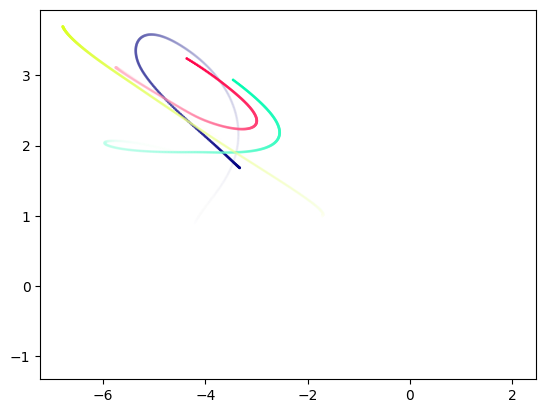

In [15]:
s.plot(0, animate=True, plot_size=False)

## We'll train on the accelerations, so let's generate the dataset:

In [54]:
accel_data = s.get_acceleration()
accel_data.shape

(10000, 500, 4, 2)

In [57]:
X = torch.from_numpy(np.concatenate([s.data[:, i] for i in range(0, s.data.shape[1], 5)]))
y = torch.from_numpy(np.concatenate([accel_data[:, i] for i in range(0, s.data.shape[1], 5)]))
X.shape, y.shape, range(0, s.data.shape[1], 5)

(torch.Size([1000000, 4, 6]), torch.Size([1000000, 4, 2]), range(0, 500, 5))

In [18]:
from sklearn.model_selection import train_test_split

In [19]:
X_train, X_test, y_train, y_test = train_test_split(X, y, shuffle=False)

# Set up the model

In [20]:
import torch
from torch import nn
from torch.functional import F
from torch.optim import Adam
from torch_geometric.nn import MetaLayer, MessagePassing

In [21]:
from models import OGN, varOGN, make_packer, make_unpacker, get_edge_index

## Use the L1 regularization model:

In [59]:
aggr = 'add'
hidden = 300

test = '_l1_'

#This test applies an explicit bottleneck:

msg_dim = 100
n_f = data.shape[3]

L1 loss: we simply add the loss to the batch number. I.e., * 32 for batch size 32.

KL loss: model the messages as a distribution with the prior a Gaussian. The means add in the final Gaussian.
Recall in the D_KL(p||q), the prior is q.  Then, for sigma_q = 1, mu_q = 0, we have ($p=1$):

$$D_{KL}(p||q) = \frac{\sigma_p^2 + \mu_p^2}{2} -\log({\sigma_p}) - \frac{1}{2}$$

## We use a custom data loader for the graphs for fast training:

In [23]:
from torch_geometric.data import Data, DataLoader

In [24]:
from models import get_edge_index

In [25]:
edge_index = get_edge_index(n, sim)

## Initiate the model:

In [26]:
if test == '_kl_':
    ogn = varOGN(n_f, msg_dim, dim, dt=0.1, hidden=hidden, edge_index=get_edge_index(n, sim), aggr=aggr).cuda()
else:
    ogn = OGN(n_f, msg_dim, dim, dt=0.1, hidden=hidden, edge_index=get_edge_index(n, sim), aggr=aggr).cuda()

messages_over_time = []
ogn = ogn.cuda()

### Let's test it:

In [22]:
_q = Data(
    x=X_train[0].cuda(),
    edge_index=edge_index.cuda(),
    y=y_train[0].cuda())
ogn(_q.x, _q.edge_index), ogn.just_derivative(_q).shape, _q.y.shape, ogn.loss(_q),

(tensor([[-0.0621,  0.0462],
         [-0.0600,  0.0343],
         [-0.0781,  0.0480],
         [-0.0671,  0.0465]], device='cuda:0', grad_fn=<AddmmBackward0>),
 torch.Size([4, 2]),
 torch.Size([4, 2]),
 tensor(24.6661, device='cuda:0', grad_fn=<SumBackward0>))

# Set up training

## Organize into data loader:

In [29]:
batch = int(64 * (4 / n)**2)
trainloader = DataLoader(
    [Data(
        Variable(X_train[i]),
        edge_index=edge_index,
        y=Variable(y_train[i])) for i in range(len(y_train))],
    batch_size=batch,
    shuffle=True
)

testloader = DataLoader(
    [Data(
        X_test[i],
        edge_index=edge_index,
        y=y_test[i]) for i in range(len(y_test))],
    batch_size=1024,
    shuffle=True
)

c:\Users\aminr\Anaconda3\envs\thesis\Lib\site-packages\torch_geometric\deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


## We'll use OneCycleLR for fast training:

In [31]:
from torch.optim.lr_scheduler import ReduceLROnPlateau, OneCycleLR

## Create the loss function

This holds definition of our L1 and KL regularizations:

In [27]:
def new_loss(self, g, augment=True, square=False):
    if square:
        return torch.sum((g.y - self.just_derivative(g, augment=augment))**2)
    else:
        base_loss = torch.sum(torch.abs(g.y - self.just_derivative(g, augment=augment)))
        if test in ['_l1_', '_kl_']:
            s1 = g.x[self.edge_index[0]]
            s2 = g.x[self.edge_index[1]]
            if test == '_l1_':
                m12 = self.message(s1, s2)
                regularization = 1e-2
                #Want one loss value per row of g.y:
                normalized_l05 = torch.sum(torch.abs(m12))
                return base_loss, regularization * batch * normalized_l05 / n**2 * n
            elif test == '_kl_':
                regularization = 1
                #Want one loss value per row of g.y:
                tmp = torch.cat([s1, s2], dim=1)  # tmp has shape [E, 2 * in_channels]
                raw_msg = self.msg_fnc(tmp)
                mu = raw_msg[:, 0::2]
                logvar = raw_msg[:, 1::2]
                full_kl = torch.sum(torch.exp(logvar) + mu**2 - logvar)/2.0
                return base_loss, regularization * batch * full_kl / n**2 * n
        return base_loss

## Set up optimizer and training parameters:

**Use 200 epochs for full version; can use fewer for test.**

In [32]:
init_lr = 1e-3

opt = torch.optim.Adam(ogn.parameters(), lr=init_lr, weight_decay=1e-8)

# total_epochs = 200
total_epochs = 200


batch_per_epoch = int(1000*10 / (batch/32.0))

sched = OneCycleLR(opt, max_lr=init_lr,
                   steps_per_epoch=batch_per_epoch,#len(trainloader),
                   epochs=total_epochs, final_div_factor=1e5)

batch_per_epoch

5000

In [33]:
epoch = 0

In [34]:
from tqdm import tqdm

## Organize the recording of messages over time

This is for fitting the forces, and extracting laws:

In [35]:
import numpy as onp
onp.random.seed(0)
test_idxes = onp.random.randint(0, len(X_test), 1000)

#Record messages over test dataset here:
newtestloader = DataLoader(
    [Data(
        X_test[i],
        edge_index=edge_index,
        y=y_test[i]) for i in test_idxes],
    batch_size=len(X_test),
    shuffle=False
)

### Function to record messages from model

In [36]:
import numpy as onp
import pandas as pd

def get_messages(ogn):

    def get_message_info(tmp):
        ogn.cpu()

        s1 = tmp.x[tmp.edge_index[0]]
        s2 = tmp.x[tmp.edge_index[1]]
        tmp = torch.cat([s1, s2], dim=1)  # tmp has shape [E, 2 * in_channels]
        if test == '_kl_':
            raw_msg = ogn.msg_fnc(tmp)
            mu = raw_msg[:, 0::2]
            logvar = raw_msg[:, 1::2]

            m12 = mu
        else:
            m12 = ogn.msg_fnc(tmp)

        all_messages = torch.cat((
            s1,
            s2,
            m12), dim=1)
        if dim == 2:
            columns = [elem%(k) for k in range(1, 3) for elem in 'x%d y%d vx%d vy%d q%d m%d'.split(' ')]
            columns += ['e%d'%(k,) for k in range(msg_dim)]
        elif dim == 3:
            columns = [elem%(k) for k in range(1, 3) for elem in 'x%d y%d z%d vx%d vy%d vz%d q%d m%d'.split(' ')]
            columns += ['e%d'%(k,) for k in range(msg_dim)]


        return pd.DataFrame(
            data=all_messages.cpu().detach().numpy(),
            columns=columns
        )

    msg_info = []
    for i, g in enumerate(newtestloader):
        msg_info.append(get_message_info(g))

    msg_info = pd.concat(msg_info)
    msg_info['dx'] = msg_info.x1 - msg_info.x2
    msg_info['dy'] = msg_info.y1 - msg_info.y2
    if dim == 2:
        msg_info['r'] = np.sqrt(
            (msg_info.dx)**2 + (msg_info.dy)**2
        )
    elif dim == 3:
        msg_info['dz'] = msg_info.z1 - msg_info.z2
        msg_info['r'] = np.sqrt(
            (msg_info.dx)**2 + (msg_info.dy)**2 + (msg_info.dz)**2
        )

    return msg_info

In [37]:
recorded_models = []

# Train the model:

## Training loop:

In [32]:
for epoch in tqdm(range(epoch, total_epochs)):
    ogn.cuda()
    total_loss = 0.0
    i = 0
    num_items = 0
    while i < batch_per_epoch:
        for ginput in trainloader:
            if i >= batch_per_epoch:
                break
            opt.zero_grad()
            ginput.x = ginput.x.cuda()
            ginput.y = ginput.y.cuda()
            ginput.edge_index = ginput.edge_index.cuda()
            ginput.batch = ginput.batch.cuda()
            if test in ['_l1_', '_kl_']:
                loss, reg = new_loss(ogn, ginput, square=False)
                ((loss + reg)/int(ginput.batch[-1]+1)).backward()
            else:
                loss = ogn.loss(ginput, square=False)
                (loss/int(ginput.batch[-1]+1)).backward()
            opt.step()
            sched.step()

            total_loss += loss.item()
            i += 1
            num_items += int(ginput.batch[-1]+1)

    cur_loss = total_loss/num_items
    print(cur_loss)
    cur_msgs = get_messages(ogn)
    cur_msgs['epoch'] = epoch
    cur_msgs['loss'] = cur_loss
    messages_over_time.append(cur_msgs)

    ogn.cpu()
    from copy import deepcopy as copy
    recorded_models.append(ogn.state_dict())

  0%|          | 1/200 [01:18<4:20:28, 78.53s/it]

12.360542467880249


  1%|          | 2/200 [02:41<4:27:29, 81.06s/it]

8.630242120361329


  2%|▏         | 3/200 [03:59<4:21:25, 79.62s/it]

6.95350202293396


  2%|▏         | 4/200 [05:16<4:17:33, 78.85s/it]

5.387773284292221


  2%|▎         | 5/200 [06:37<4:18:02, 79.40s/it]

4.681907528543472


  3%|▎         | 6/200 [07:58<4:18:13, 79.86s/it]

4.274312264966965


  4%|▎         | 7/200 [09:24<4:23:47, 82.01s/it]

3.962014359140396


  4%|▍         | 8/200 [10:44<4:20:48, 81.50s/it]

3.8522035227537157


  4%|▍         | 9/200 [12:03<4:16:19, 80.52s/it]

3.6514243382692335


  5%|▌         | 10/200 [13:21<4:13:11, 79.96s/it]

3.5034412845373155


  6%|▌         | 11/200 [14:40<4:10:56, 79.66s/it]

3.3369242843151095


  6%|▌         | 12/200 [16:03<4:11:59, 80.42s/it]

3.1838468205928803


  6%|▋         | 13/200 [17:22<4:09:27, 80.04s/it]

3.0508350778102873


  7%|▋         | 14/200 [18:39<4:05:53, 79.32s/it]

2.833906013560295


  8%|▊         | 15/200 [19:57<4:03:15, 78.89s/it]

2.709748810172081


  8%|▊         | 16/200 [21:15<4:01:12, 78.65s/it]

2.49969818983078


  8%|▊         | 17/200 [22:32<3:58:00, 78.04s/it]

2.281795781934261


  9%|▉         | 18/200 [23:53<3:58:57, 78.78s/it]

2.0716564539909363


 10%|▉         | 19/200 [25:10<3:56:49, 78.50s/it]

1.8638611411094665


 10%|█         | 20/200 [26:30<3:56:47, 78.93s/it]

1.7536994464993476


 10%|█         | 21/200 [27:48<3:54:02, 78.45s/it]

1.6551584590911865


 11%|█         | 22/200 [29:04<3:50:40, 77.75s/it]

1.6077861025691031


 12%|█▏        | 23/200 [30:17<3:45:06, 76.31s/it]

1.507537025654316


 12%|█▏        | 24/200 [31:34<3:44:49, 76.64s/it]

1.46589471244812


 12%|█▎        | 25/200 [32:51<3:43:58, 76.79s/it]

1.3759536993265151


 13%|█▎        | 26/200 [34:10<3:44:04, 77.26s/it]

1.4114311017990113


 14%|█▎        | 27/200 [35:28<3:43:24, 77.48s/it]

1.3783381672620774


 14%|█▍        | 28/200 [36:45<3:42:09, 77.50s/it]

1.3960605239987374


 14%|█▍        | 29/200 [38:03<3:41:28, 77.71s/it]

1.34807431319952


 15%|█▌        | 30/200 [39:22<3:41:20, 78.12s/it]

1.3595098209440708


 16%|█▌        | 31/200 [40:41<3:40:04, 78.13s/it]

1.372971514570713


 16%|█▌        | 32/200 [42:02<3:41:16, 79.03s/it]

1.3636841394543648


 16%|█▋        | 33/200 [43:21<3:39:59, 79.04s/it]

1.3765302829802035


 17%|█▋        | 34/200 [44:39<3:37:40, 78.68s/it]

1.3986860156416894


 18%|█▊        | 35/200 [45:56<3:35:06, 78.22s/it]

1.3859416321754456


 18%|█▊        | 36/200 [47:14<3:33:53, 78.26s/it]

1.3595270444869996


 18%|█▊        | 37/200 [48:30<3:30:15, 77.40s/it]

1.37229977799654


 19%|█▉        | 38/200 [49:43<3:25:54, 76.26s/it]

1.4186862812519074


 20%|█▉        | 39/200 [50:55<3:21:03, 74.93s/it]

1.43333310546875


 20%|██        | 40/200 [52:07<3:17:35, 74.10s/it]

1.3828425859689712


 20%|██        | 41/200 [53:22<3:16:59, 74.33s/it]

1.3585131377339363


 21%|██        | 42/200 [54:37<3:15:53, 74.39s/it]

1.3706995043754577


 22%|██▏       | 43/200 [55:54<3:17:01, 75.30s/it]

1.409587586414814


 22%|██▏       | 44/200 [57:11<3:17:30, 75.96s/it]

1.361754267501831


 22%|██▎       | 45/200 [58:28<3:16:37, 76.11s/it]

1.3668217945218086


 23%|██▎       | 46/200 [59:44<3:15:16, 76.08s/it]

1.343883875155449


 24%|██▎       | 47/200 [1:01:00<3:14:10, 76.15s/it]

1.3729744076251984


 24%|██▍       | 48/200 [1:02:17<3:13:20, 76.32s/it]

1.3608219263076782


 24%|██▍       | 49/200 [1:03:33<3:11:52, 76.24s/it]

1.3286784060955048


 25%|██▌       | 50/200 [1:04:49<3:10:42, 76.28s/it]

1.3188957794070244


 26%|██▌       | 51/200 [1:06:05<3:09:15, 76.21s/it]

1.3261499412059783


 26%|██▌       | 52/200 [1:07:22<3:08:09, 76.28s/it]

1.315011288678646


 26%|██▋       | 53/200 [1:08:39<3:07:37, 76.58s/it]

1.2771140587687493


 27%|██▋       | 54/200 [1:09:57<3:07:15, 76.95s/it]

1.2732744723379612


 28%|██▊       | 55/200 [1:11:16<3:07:16, 77.49s/it]

1.280917429536581


 28%|██▊       | 56/200 [1:12:34<3:06:42, 77.79s/it]

1.2593985993921757


 28%|██▊       | 57/200 [1:13:53<3:05:45, 77.94s/it]

1.230505443817377


 29%|██▉       | 58/200 [1:15:11<3:04:39, 78.03s/it]

1.2161348463356494


 30%|██▉       | 59/200 [1:16:28<3:02:49, 77.80s/it]

1.1852797114789486


 30%|███       | 60/200 [1:17:46<3:01:34, 77.82s/it]

1.202589388114214


 30%|███       | 61/200 [1:19:03<2:59:49, 77.62s/it]

1.1782967542767524


 31%|███       | 62/200 [1:20:21<2:58:56, 77.80s/it]

1.1265932913780212


 32%|███▏      | 63/200 [1:21:40<2:58:04, 77.99s/it]

1.1267962365865707


 32%|███▏      | 64/200 [1:22:56<2:55:41, 77.51s/it]

1.1567236436963082


 32%|███▎      | 65/200 [1:24:13<2:53:53, 77.29s/it]

1.1067127838015556


 33%|███▎      | 66/200 [1:25:31<2:53:11, 77.55s/it]

1.0809390331923963


 34%|███▎      | 67/200 [1:26:48<2:51:41, 77.46s/it]

1.0829669832825661


 34%|███▍      | 68/200 [1:28:07<2:50:56, 77.70s/it]

1.080514416450262


 34%|███▍      | 69/200 [1:29:24<2:49:42, 77.73s/it]

1.0490192672610283


 35%|███▌      | 70/200 [1:30:42<2:48:26, 77.74s/it]

1.0508108358502388


 36%|███▌      | 71/200 [1:32:07<2:51:40, 79.85s/it]

1.0310980152785778


 36%|███▌      | 72/200 [1:33:24<2:48:50, 79.14s/it]

1.0052022817373276


 36%|███▋      | 73/200 [1:34:40<2:45:34, 78.23s/it]

1.0011637781322003


 37%|███▋      | 74/200 [1:35:57<2:43:04, 77.66s/it]

0.994937193030119


 38%|███▊      | 75/200 [1:37:13<2:40:49, 77.20s/it]

1.0125177087128163


 38%|███▊      | 76/200 [1:38:30<2:39:16, 77.07s/it]

0.9810063882470131


 38%|███▊      | 77/200 [1:39:50<2:39:42, 77.91s/it]

0.9797882618784904


 39%|███▉      | 78/200 [1:41:08<2:38:47, 78.09s/it]

0.9656964405894279


 40%|███▉      | 79/200 [1:42:26<2:37:39, 78.18s/it]

0.9590282727956772


 40%|████      | 80/200 [1:43:41<2:34:09, 77.08s/it]

0.9211883447289467


 40%|████      | 81/200 [1:44:57<2:32:11, 76.74s/it]

0.9100545532464981


 41%|████      | 82/200 [1:46:09<2:28:09, 75.33s/it]

0.8908111764967441


 42%|████▏     | 83/200 [1:47:20<2:24:21, 74.03s/it]

0.8888334337472915


 42%|████▏     | 84/200 [1:48:32<2:21:44, 73.32s/it]

0.8789806627511978


 42%|████▎     | 85/200 [1:49:44<2:19:50, 72.96s/it]

0.8664224189400673


 43%|████▎     | 86/200 [1:50:58<2:19:06, 73.22s/it]

0.8531069457769394


 44%|████▎     | 87/200 [1:52:22<2:24:13, 76.58s/it]

0.8506323798179627


 44%|████▍     | 88/200 [1:53:37<2:21:56, 76.04s/it]

0.8405230204164982


 44%|████▍     | 89/200 [1:54:53<2:20:37, 76.02s/it]

0.8290839950799942


 45%|████▌     | 90/200 [1:56:07<2:18:32, 75.57s/it]

0.819436622607708


 46%|████▌     | 91/200 [1:57:21<2:16:30, 75.14s/it]

0.8067641348659992


 46%|████▌     | 92/200 [1:58:34<2:13:48, 74.34s/it]

0.8106039220452309


 46%|████▋     | 93/200 [1:59:46<2:11:40, 73.83s/it]

0.7866713663697242


 47%|████▋     | 94/200 [2:01:01<2:11:00, 74.15s/it]

0.7908646999418736


 48%|████▊     | 95/200 [2:02:18<2:11:03, 74.89s/it]

0.756406781488657


 48%|████▊     | 96/200 [2:03:36<2:11:20, 75.77s/it]

0.7711522863566875


 48%|████▊     | 97/200 [2:04:53<2:10:42, 76.14s/it]

0.7517710423767566


 49%|████▉     | 98/200 [2:06:11<2:10:22, 76.70s/it]

0.7426627645730972


 50%|████▉     | 99/200 [2:07:29<2:09:50, 77.13s/it]

0.7335593158721924


 50%|█████     | 100/200 [2:08:49<2:09:56, 77.96s/it]

0.7181549483895302


 50%|█████     | 101/200 [2:10:02<2:06:13, 76.50s/it]

0.7147298771858215


 51%|█████     | 102/200 [2:11:18<2:04:34, 76.27s/it]

0.7241471445083618


 52%|█████▏    | 103/200 [2:12:35<2:03:38, 76.48s/it]

0.6814859388411045


 52%|█████▏    | 104/200 [2:13:52<2:02:36, 76.63s/it]

0.7055548837900162


 52%|█████▎    | 105/200 [2:15:07<2:00:52, 76.35s/it]

0.6929070802807807


 53%|█████▎    | 106/200 [2:16:21<1:58:17, 75.51s/it]

0.6719541329085826


 54%|█████▎    | 107/200 [2:17:34<1:55:51, 74.75s/it]

0.6652224213778972


 54%|█████▍    | 108/200 [2:18:47<1:54:02, 74.37s/it]

0.6520491295576095


 55%|█████▍    | 109/200 [2:20:01<1:52:19, 74.06s/it]

0.6500845532059669


 55%|█████▌    | 110/200 [2:21:14<1:50:53, 73.92s/it]

0.6367404191434384


 56%|█████▌    | 111/200 [2:22:27<1:49:18, 73.69s/it]

0.6350400341868401


 56%|█████▌    | 112/200 [2:23:40<1:47:39, 73.40s/it]

0.6217218951761723


 56%|█████▋    | 113/200 [2:24:54<1:46:26, 73.41s/it]

0.5968869416832924


 57%|█████▋    | 114/200 [2:26:08<1:45:33, 73.65s/it]

0.598415159034729


 57%|█████▊    | 115/200 [2:27:25<1:45:58, 74.81s/it]

0.5852635890185833


 58%|█████▊    | 116/200 [2:28:45<1:46:44, 76.24s/it]

0.5938086104214192


 58%|█████▊    | 117/200 [2:30:08<1:48:10, 78.20s/it]

0.5783099977195263


 59%|█████▉    | 118/200 [2:31:23<1:45:44, 77.37s/it]

0.5664541788876056


 60%|█████▉    | 119/200 [2:32:35<1:42:04, 75.61s/it]

0.5651855288088322


 60%|██████    | 120/200 [2:33:45<1:38:41, 74.02s/it]

0.5551959563463926


 60%|██████    | 121/200 [2:34:56<1:36:10, 73.05s/it]

0.5312659598082304


 61%|██████    | 122/200 [2:36:07<1:34:27, 72.65s/it]

0.5255471799701452


 62%|██████▏   | 123/200 [2:37:18<1:32:33, 72.13s/it]

0.5387659298241139


 62%|██████▏   | 124/200 [2:38:27<1:30:06, 71.14s/it]

0.5083868072628975


 62%|██████▎   | 125/200 [2:39:36<1:28:04, 70.46s/it]

0.5084187651216984


 63%|██████▎   | 126/200 [2:40:45<1:26:20, 70.00s/it]

0.510662393143773


 64%|██████▎   | 127/200 [2:41:53<1:24:32, 69.49s/it]

0.4981389599919319


 64%|██████▍   | 128/200 [2:43:02<1:23:14, 69.37s/it]

0.479718372631073


 64%|██████▍   | 129/200 [2:44:11<1:21:54, 69.22s/it]

0.4679506300032139


 65%|██████▌   | 130/200 [2:45:21<1:21:00, 69.43s/it]

0.47250008785426617


 66%|██████▌   | 131/200 [2:46:35<1:21:30, 70.88s/it]

0.44942483419775964


 66%|██████▌   | 132/200 [2:47:49<1:21:06, 71.56s/it]

0.4471366962820292


 66%|██████▋   | 133/200 [2:49:01<1:20:17, 71.90s/it]

0.4365408507287502


 67%|██████▋   | 134/200 [2:50:16<1:20:07, 72.85s/it]

0.4376790670365095


 68%|██████▊   | 135/200 [2:51:33<1:20:08, 73.98s/it]

0.4320957512408495


 68%|██████▊   | 136/200 [2:52:52<1:20:24, 75.38s/it]

0.41936991971731186


 68%|██████▊   | 137/200 [2:54:10<1:20:12, 76.39s/it]

0.4121303583741188


 69%|██████▉   | 138/200 [2:55:29<1:19:45, 77.19s/it]

0.40488864364027977


 70%|██████▉   | 139/200 [2:56:49<1:19:09, 77.86s/it]

0.3990825733959675


 70%|███████   | 140/200 [2:58:08<1:18:14, 78.25s/it]

0.3828788033336401


 70%|███████   | 141/200 [2:59:28<1:17:35, 78.90s/it]

0.38769429115355014


 71%|███████   | 142/200 [3:00:48<1:16:29, 79.13s/it]

0.376939101216197


 72%|███████▏  | 143/200 [3:02:08<1:15:18, 79.28s/it]

0.36776781635582445


 72%|███████▏  | 144/200 [3:03:28<1:14:14, 79.54s/it]

0.36134996365308764


 72%|███████▎  | 145/200 [3:04:49<1:13:25, 80.11s/it]

0.3603053486853838


 73%|███████▎  | 146/200 [3:06:10<1:12:14, 80.27s/it]

0.3467296982139349


 74%|███████▎  | 147/200 [3:07:30<1:10:53, 80.26s/it]

0.34570229711830613


 74%|███████▍  | 148/200 [3:08:55<1:10:43, 81.61s/it]

0.3388150197774172


 74%|███████▍  | 149/200 [3:10:22<1:10:41, 83.17s/it]

0.33895581744909287


 75%|███████▌  | 150/200 [3:11:48<1:10:02, 84.06s/it]

0.32059016569554805


 76%|███████▌  | 151/200 [3:13:12<1:08:39, 84.08s/it]

0.31559768126904963


 76%|███████▌  | 152/200 [3:14:36<1:07:21, 84.20s/it]

0.3087655590772629


 76%|███████▋  | 153/200 [3:15:57<1:05:05, 83.11s/it]

0.3077827584594488


 77%|███████▋  | 154/200 [3:17:17<1:03:01, 82.20s/it]

0.2999732764691114


 78%|███████▊  | 155/200 [3:18:37<1:01:06, 81.47s/it]

0.29690645145773886


 78%|███████▊  | 156/200 [3:19:56<59:15, 80.81s/it]  

0.28879854126274584


 78%|███████▊  | 157/200 [3:21:16<57:43, 80.54s/it]

0.2890184380620718


 79%|███████▉  | 158/200 [3:22:35<56:04, 80.12s/it]

0.2808829139977694


 80%|███████▉  | 159/200 [3:23:50<53:39, 78.53s/it]

0.27682730050981047


 80%|████████  | 160/200 [3:25:03<51:18, 76.96s/it]

0.2695796919822693


 80%|████████  | 161/200 [3:26:18<49:32, 76.23s/it]

0.26464855655431746


 81%|████████  | 162/200 [3:27:32<47:53, 75.61s/it]

0.26147079686522484


 82%|████████▏ | 163/200 [3:28:45<46:04, 74.71s/it]

0.2596024586796761


 82%|████████▏ | 164/200 [3:29:59<44:48, 74.67s/it]

0.2549485437184572


 82%|████████▎ | 165/200 [3:31:19<44:23, 76.11s/it]

0.24933162242174148


 83%|████████▎ | 166/200 [3:32:39<43:52, 77.42s/it]

0.24514965475201606


 84%|████████▎ | 167/200 [3:33:55<42:17, 76.88s/it]

0.24126070645153522


 84%|████████▍ | 168/200 [3:35:12<41:01, 76.93s/it]

0.2386801291078329


 84%|████████▍ | 169/200 [3:36:31<40:01, 77.47s/it]

0.23399273342788218


 85%|████████▌ | 170/200 [3:37:50<39:05, 78.19s/it]

0.23134442776739597


 86%|████████▌ | 171/200 [3:39:10<37:57, 78.53s/it]

0.2284805571168661


 86%|████████▌ | 172/200 [3:40:30<36:53, 79.07s/it]

0.22622234956920148


 86%|████████▋ | 173/200 [3:41:50<35:45, 79.45s/it]

0.22250736690461637


 87%|████████▋ | 174/200 [3:43:11<34:34, 79.79s/it]

0.22012999839484693


 88%|████████▊ | 175/200 [3:44:30<33:10, 79.63s/it]

0.21709135100245475


 88%|████████▊ | 176/200 [3:45:47<31:33, 78.88s/it]

0.2139121487379074


 88%|████████▊ | 177/200 [3:46:59<29:25, 76.76s/it]

0.21320894800126552


 89%|████████▉ | 178/200 [3:48:16<28:08, 76.75s/it]

0.2104954074472189


 90%|████████▉ | 179/200 [3:49:32<26:44, 76.42s/it]

0.20851970004737377


 90%|█████████ | 180/200 [3:50:47<25:22, 76.15s/it]

0.20707569628059863


 90%|█████████ | 181/200 [3:52:03<24:04, 76.04s/it]

0.20459018724560737


 91%|█████████ | 182/200 [3:53:24<23:14, 77.47s/it]

0.2027744774967432


 92%|█████████▏| 183/200 [3:54:43<22:05, 77.98s/it]

0.2012653492987156


 92%|█████████▏| 184/200 [3:56:03<20:57, 78.57s/it]

0.19989543598890305


 92%|█████████▎| 185/200 [3:57:23<19:46, 79.08s/it]

0.1979676426142454


 93%|█████████▎| 186/200 [3:58:44<18:34, 79.60s/it]

0.1967547134935856


 94%|█████████▎| 187/200 [4:00:05<17:20, 80.01s/it]

0.19577874286472796


 94%|█████████▍| 188/200 [4:01:29<16:14, 81.24s/it]

0.1942166533857584


 94%|█████████▍| 189/200 [4:02:55<15:08, 82.57s/it]

0.1935636551350355


 95%|█████████▌| 190/200 [4:04:20<13:54, 83.43s/it]

0.1919457396954298


 96%|█████████▌| 191/200 [4:05:46<12:37, 84.16s/it]

0.19240290029346943


 96%|█████████▌| 192/200 [4:07:12<11:16, 84.61s/it]

0.19133377353549003


 96%|█████████▋| 193/200 [4:08:37<09:54, 84.88s/it]

0.19007829385697841


 97%|█████████▋| 194/200 [4:10:07<08:38, 86.48s/it]

0.19002596253454684


 98%|█████████▊| 195/200 [4:11:43<07:25, 89.15s/it]

0.18924161337018014


 98%|█████████▊| 196/200 [4:13:11<05:56, 89.00s/it]

0.18894196226000787


 98%|█████████▊| 197/200 [4:14:39<04:26, 88.71s/it]

0.18855994800925255


 99%|█████████▉| 198/200 [4:16:07<02:56, 88.46s/it]

0.18866721045970916


100%|█████████▉| 199/200 [4:17:35<01:28, 88.34s/it]

0.1879547338038683


100%|██████████| 200/200 [4:19:03<00:00, 77.72s/it]

0.18804085052907468


Normally you should run all the way to 200 epochs (set this as a parameter so that OneCycleLR is set correctly). This loop was cut off early to quickly test this notebook.

## Save and Load models here to prevent re-training:

In [38]:
import pickle as pkl

# pkl.dump(messages_over_time,
#     open('messages_over_time.pkl', 'wb'))

# pkl.dump(recorded_models,
#     open('models_over_time.pkl', 'wb'))

In [39]:
messages_over_time = pkl.load(open('messages_over_time.pkl', 'rb'))
recorded_models = pkl.load(open('models_over_time.pkl', 'rb'))

# Analyze trained model:

## Plot a comparison of the force components with the messages:

### (Or plot the rotation or sparsity - turn these on and off with flags:)

In [40]:
from celluloid import Camera
from copy import deepcopy as copy

Options include:

- plot_force_components: the scatter plots of true force versus message
- plot_sparsity: the grayscale animation of the message components over time
- plot_rotation: plot the vectors showing how the messages are rotations of the true vectors

spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.2464373327184606
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.26596745243778935
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.27105880172164354
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.32556051748770254
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.33837094907407406
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.28740133780020255
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.2802489669234664
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.26754139087818285
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.2603869741934317
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.24626218442563655
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.23733528419777197
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.223262939453125
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.12528194003634982
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.11440487331814235
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.09399358678747106
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.075395725391529

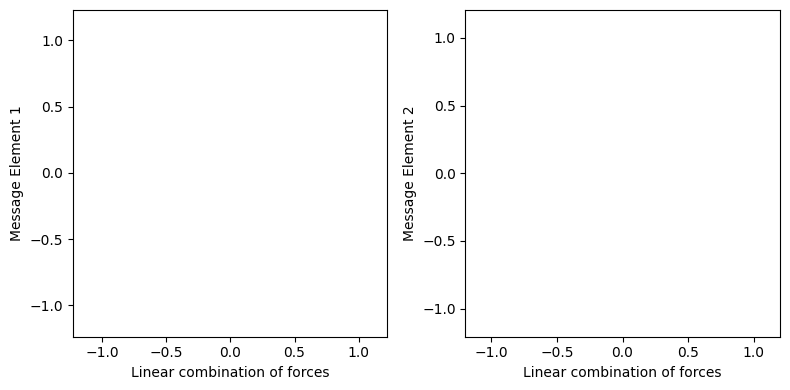

In [41]:

#Only turn on one of these:
plot_force_components = True
plot_sparsity = False
plot_rotation = False
if plot_force_components:
    fig, ax = plt.subplots(1, dim, figsize=(4*dim, 4))
if plot_sparsity or plot_rotation:
    fig, ax = plt.subplots(1, 1)
cam = Camera(fig)


last_alpha_x1 = 0.0
last_alpha_y1 = 0.0
t = lambda _: _#tqdm
for i in t(range(0, len(messages_over_time), 1)):
    msgs = copy(messages_over_time[i])

    msgs['bd'] = msgs.r + 1e-2

    try:
        msg_columns = ['e%d'%(k) for k in range(1, msg_dim+1)]
        msg_array = np.array(msgs[msg_columns])
    except:
        msg_columns = ['e%d'%(k) for k in range(msg_dim)]
        msg_array = np.array(msgs[msg_columns])

    msg_importance = msg_array.std(axis=0)
    most_important = np.argsort(msg_importance)[-dim:]
    msgs_to_compare = msg_array[:, most_important]
    msgs_to_compare = (msgs_to_compare - np.average(msgs_to_compare, axis=0)) / np.std(msgs_to_compare, axis=0)

    if plot_sparsity:
        ax.pcolormesh(msg_importance[np.argsort(msg_importance)[::-1][None, :15]], cmap='gray_r', edgecolors='k')
        # plt.colorbar()
        plt.axis('off')
        plt.grid(True)
        ax.set_aspect('equal')
        plt.text(15.5, 0.5, '...', fontsize=30)
        # fig.suptitle(title + test + 'mse=%.3e'%(min_result.fun/len(msgs),))
        plt.tight_layout()

    if plot_force_components or plot_rotation:
        pos_cols = ['dx', 'dy']
        if dim == 3:
            pos_cols.append('dz')

        if sim != 'spring':
            raise NotImplementedError("The current force function is for a spring. You will need to change the force function below to that expected by your simulation.")
        force_fnc = lambda msg: np.asarray(-(msg.bd - 1))[:, None] * np.array(msg[pos_cols]) / np.asarray(msg.bd)[:, None]

        expected_forces = force_fnc(msgs)

        def percentile_sum(x):
            x = x.ravel()
            bot = x.min()
            top = np.percentile(x, 90)
            msk = (x>=bot) & (x<=top)
            frac_good = (msk).sum()/len(x)
            return x[msk].sum()/frac_good

        from scipy.optimize import minimize

        def linear_transformation_2d(alpha):

            lincomb1 = (alpha[0] * expected_forces[:, 0] + alpha[1] * expected_forces[:, 1]) + alpha[2]
            lincomb2 = (alpha[3] * expected_forces[:, 0] + alpha[4] * expected_forces[:, 1]) + alpha[5]

            score = (
                percentile_sum(np.square(msgs_to_compare[:, 0] - lincomb1)) +
                percentile_sum(np.square(msgs_to_compare[:, 1] - lincomb2))
            )/2.0

            return score

        def out_linear_transformation_2d(alpha):
            lincomb1 = (alpha[0] * expected_forces[:, 0] + alpha[1] * expected_forces[:, 1]) + alpha[2]
            lincomb2 = (alpha[3] * expected_forces[:, 0] + alpha[4] * expected_forces[:, 1]) + alpha[5]

            return lincomb1, lincomb2

        def linear_transformation_3d(alpha):

            lincomb1 = (alpha[0] * expected_forces[:, 0] + alpha[1] * expected_forces[:, 1] + alpha[2] * expected_forces[:, 2]) + alpha[3]
            lincomb2 = (alpha[0+4] * expected_forces[:, 0] + alpha[1+4] * expected_forces[:, 1] + alpha[2+4] * expected_forces[:, 2]) + alpha[3+4]
            lincomb3 = (alpha[0+8] * expected_forces[:, 0] + alpha[1+8] * expected_forces[:, 1] + alpha[2+8] * expected_forces[:, 2]) + alpha[3+8]

            score = (
                percentile_sum(np.square(msgs_to_compare[:, 0] - lincomb1)) +
                percentile_sum(np.square(msgs_to_compare[:, 1] - lincomb2)) +
                percentile_sum(np.square(msgs_to_compare[:, 2] - lincomb3))
            )/3.0

            return score

        def out_linear_transformation_3d(alpha):

            lincomb1 = (alpha[0] * expected_forces[:, 0] + alpha[1] * expected_forces[:, 1] + alpha[2] * expected_forces[:, 2]) + alpha[3]
            lincomb2 = (alpha[0+4] * expected_forces[:, 0] + alpha[1+4] * expected_forces[:, 1] + alpha[2+4] * expected_forces[:, 2]) + alpha[3+4]
            lincomb3 = (alpha[0+8] * expected_forces[:, 0] + alpha[1+8] * expected_forces[:, 1] + alpha[2+8] * expected_forces[:, 2]) + alpha[3+8]

            return lincomb1, lincomb2, lincomb3

        if dim == 2:
            min_result = minimize(linear_transformation_2d, np.ones(dim**2 + dim), method='Powell')
        if dim == 3:
            min_result = minimize(linear_transformation_3d, np.ones(dim**2 + dim), method='Powell')
        print(title, test, 'gets', min_result.fun/len(msgs))

        if plot_rotation:
            q = min_result.x
            alphax1, alphay1, offset1 = q[:3]
            alphax2, alphay2, offset2 = q[3:]

            s1 = alphax1**2 + alphay1**2
            s2 = alphax2**2 + alphay2**2

            if (
                    (alphax2 - last_alpha_x1)**2
                    + (alphay2 - last_alpha_y1)**2  <
                   (alphax1 - last_alpha_x1)**2
                    + (alphay1 - last_alpha_y1)**2):

                alphax1, alphay1, offset1 = q[3:]
                alphax2, alphay2, offset2 = q[:3]

            last_alpha_x1 = alphax1
            last_alpha_y1 = alphay1
            s1 = alphax1**2 + alphay1**2
            s2 = alphax2**2 + alphay2**2
            alphax1 /= s1**0.5 * 2
            alphay1 /= s1**0.5 * 2
            alphax2 /= s2**0.5 * 2
            alphay2 /= s2**0.5 * 2

            ax.arrow(0.5, 0.5, alphax1, alphay1, color='k', head_width=0.05, length_includes_head=True)
            ax.arrow(0.5, 0.5, alphax2, alphay2, color='k', head_width=0.05, length_includes_head=True)
            ax.axis('off')

        if plot_force_components:
            for i in range(dim):
                if dim == 3:
                    px = out_linear_transformation_3d(min_result.x)[i]
                else:
                    px = out_linear_transformation_2d(min_result.x)[i]

                py = msgs_to_compare[:, i]
                ax[i].scatter(px, py,
                              alpha=0.1, s=0.1, color='k')
                ax[i].set_xlabel('Linear combination of forces')
                ax[i].set_ylabel('Message Element %d'%(i+1))

                xlim = np.array([np.percentile(px, q) for q in [10, 90]])
                ylim = np.array([np.percentile(py, q) for q in [10, 90]])
                xlim[0], xlim[1] = xlim[0] - (xlim[1] - xlim[0])*0.05, xlim[1] + (xlim[1] - xlim[0])*0.05
                ylim[0], ylim[1] = ylim[0] - (ylim[1] - ylim[0])*0.05, ylim[1] + (ylim[1] - ylim[0])*0.05

                ax[i].set_xlim(xlim)
                ax[i].set_ylim(ylim)

        plt.tight_layout()

    cam.snap()

ani = cam.animate()

from IPython.display import HTML
HTML(ani.to_jshtml())

## Plot some predicted versus true trajectories:

In [42]:
from simulate import make_transparent_color

In [43]:
from scipy.integrate import odeint

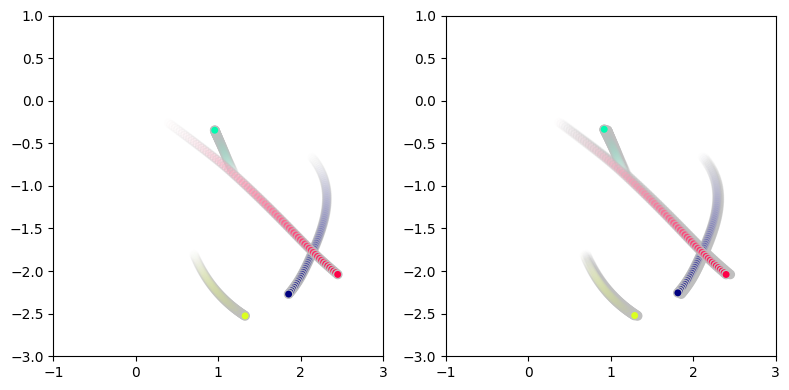

In [44]:
fig, ax = plt.subplots(1, 2, figsize=(8, 4))
camera = Camera(fig)

for current_model in [-1] + [1, 34, 67, 100, 133, 166, 199]:
    i = 4 #Use this simulation
    if current_model > len(recorded_models):
        continue

    #Truth:
    cutoff_time = 300
    times = onp.array(s.times)[:cutoff_time]
    x_times = onp.array(data[i, :cutoff_time])
    masses = x_times[:, :, -1]
    length_of_tail = 75

    #Learned:
    e = edge_index.cuda()
    ogn.cpu()
    if current_model > -1:
        ogn.load_state_dict(recorded_models[current_model])
    else:
        # Random model!
        ogn = OGN(n_f, msg_dim, dim, dt=0.1, hidden=hidden, edge_index=get_edge_index(n, sim), aggr=aggr).cuda()
    ogn.cuda()

    def odefunc(y, t=None):
        y = y.reshape(4, 6).astype(np.float32)
        cur = Data(
            x=torch.from_numpy(y).cuda(),
            edge_index=e
        )
        dx = y[:, 2:4]
        dv = ogn.just_derivative(cur).cpu().detach().numpy()
        dother = np.zeros_like(dx)
        return np.concatenate((dx, dv, dother), axis=1).ravel()

    datai = odeint(odefunc, (onp.asarray(x_times[0]).ravel()), times).reshape(-1, 4, 6)
    x_times2 = onp.array(datai)

    d_idx = 10
    for t_idx in range(d_idx, cutoff_time, d_idx):
        start = max([0, t_idx-length_of_tail])
        ctimes = times[start:t_idx]
        cx_times = x_times[start:t_idx]
        cx_times2 = x_times2[start:t_idx]
        for j in range(n):
            rgba = make_transparent_color(len(ctimes), j/n)
            ax[0].scatter(cx_times[:, j, 0], cx_times[:, j, 1], color=rgba)
            ax[1].scatter(cx_times2[:, j, 0], cx_times2[:, j, 1], color=rgba)
            black_rgba = rgba
            black_rgba[:, :3] = 0.75
            ax[1].scatter(cx_times[:, j, 0], cx_times[:, j, 1], color=black_rgba, zorder=-1)

        for k in range(2):
            ax[k].set_xlim(-1, 3)
            ax[k].set_ylim(-3, 1)
        plt.tight_layout()
        camera.snap()

# camera.animate().save('multiple_animations_with_comparison.mp4')
from IPython.display import HTML
HTML(camera.animate().to_jshtml())

# Symbolic regression

Extract the force laws with the following procedure:
- The data in `messages_over_time` correspond to inputs to, and features of, $\phi^e$, recorded during each training epoch.
- Select the last element of this list.
- Find the most significant message feature. Each message feature corresponds to 'e1', 'e2', etc. Calculate the one with the largest standard deviation.

Train [PySR](https://github.com/MilesCranmer/PySR) to fit this relationship.
Thus, we have extracted a force law from the graph network without priors on the functional form.

This is the same technique we used to extract the unknown dark matter overdensity equation from the Quijote simulations.


## Here's the best message, which we will study:

In [45]:
best_message = np.argmax([np.std(messages_over_time[-1]['e%d'%(i,)]) for i in range(100)])

## Here's a pandas dataframe of the message data:

In [46]:
messages_over_time[-1][['e%d'%(best_message,), 'dx', 'dy', 'r', 'm1', 'm2']]

,e46,dx,dy,r,m1,m2
0,-0.030190,0.543488,-0.778920,0.949787,5.785905,0.836671
1,-0.216116,1.947127,1.091559,2.232220,5.785905,0.770745
2,-0.039454,0.818094,-0.411026,0.915544,5.785905,0.800204
3,0.027430,-0.543488,0.778920,0.949787,0.836671,5.785905
4,-0.615072,1.403639,1.870479,2.338567,0.836671,0.770745
...,...,...,...,...,...,...
11995,-0.197095,0.491158,-0.143346,0.511648,0.163864,0.695851
11996,-0.029756,0.882843,-0.116667,0.890518,0.163864,1.765544
11997,-0.375647,0.827243,1.477602,1.693411,1.765544,0.581951
11998,0.100787,-0.391685,-0.026679,0.392593,1.765544,0.695851


## Now we just fit e4 as a function of dx, dy, r, m1, and m2, inside [PySR](https://github.com/MilesCranmer/PySR).

In [47]:
from pysr import PySRRegressor

model = PySRRegressor(
    niterations=100,  # < Increase me for better results
    binary_operators=["+", "*", "-", "/"],
    unary_operators=[
        "cos",
        "exp",
        "sin",
        "inv(x) = 1/x",
        # ^ Custom operator (julia syntax)
    ],
    extra_sympy_mappings={"inv": lambda x: 1 / x},
    # ^ Define operator for SymPy as well
    elementwise_loss="loss(prediction, target) = (prediction - target)^2",
    # ^ Custom loss function (julia syntax)
    batching = True
)

c:\Users\aminr\Anaconda3\envs\thesis\Lib\site-packages\juliacall\__init__.py:60: UserWarning: torch was imported before juliacall. This may cause a segfault. To avoid this, import juliacall before importing torch. For updates, see https://github.com/pytorch/pytorch/issues/78829.
  warnings.warn(


Detected IPython. Loading juliacall extension. See https://juliapy.github.io/PythonCall.jl/stable/compat/#IPython


In [48]:
model.fit(messages_over_time[-1][['dx']], messages_over_time[-1][['dy']])

c:\Users\aminr\Anaconda3\envs\thesis\Lib\site-packages\pysr\sr.py:1307: UserWarning: Note: it looks like you are running in Jupyter. The progress bar will be turned off.
  warnings.warn(


Compiling Julia backend...


[ Info: Started!



Expressions evaluated per second: 5.130e+03
Head worker occupation: 17.5%
Progress: 349 / 1500 total iterations (23.267%)
Hall of Fame:
---------------------------------------------------------------------------------------------------
Complexity  Loss       Score     Equation
1           1.410e+00  1.594e+01  y = -0.006874
2           1.410e+00  3.254e-05  y = sin(-0.0010762)
3           1.410e+00  1.626e-04  y = dx * 0.017777
4           1.409e+00  2.420e-04  y = sin(dx) * 0.018383
5           1.409e+00  1.674e-04  y = sin(sin(dx) * 0.035097)
6           1.409e+00  -0.000e+00  y = sin(sin(dx) * sin(0.035097))
11          1.409e+00  1.410e-05  y = sin(sin(3.0985)) * sin((0.26537 + dx) / cos(0.67817))
12          1.409e+00  8.178e-05  y = (0.54723 - sin(sin(dx) * sin(dx))) * (-0.11941 * dx)
20          1.409e+00  2.787e-06  y = -0.11814 * (cos(inv(cos(sin(exp(cos(dx)) + cos(-0.3464 - c...
                                  os(sin(-0.36928)))))) - -0.19887) * dx)
-----------------------

PySRRegressor.equations_ = [
	    pick         score                                           equation  \
	0         0.000000e+00                                      -0.0010946942   
	1         6.383314e-07                                     exp(-9.652866)   
	2         1.826504e-04                                 -0.0009991251 / dx   
	3   >>>>  3.908067e-04                              sin(dx) * 0.047366016   
	4         3.359094e-06          sin((-0.08204235 / -1.8744133) * sin(dx))   
	5         1.845147e-06       (cos(sin(1.2360287)) * sin(dx)) * 0.07023606   
	6         8.807813e-05       (cos(dx + dx) * (-0.078247 / 2.025427)) * dx   
	7         4.400775e-06  (sin(0.54723066) - sin(sin(dx) * sin(dx))) * (...   
	8         1.044235e-04  ((0.3372963 / 0.9689235) - sin(sin(inv(dx)) * ...   
	9         1.632899e-06  sin(((0.3372963 / 0.9689235) - sin(sin(inv(dx)...   
	10        1.292129e-05  (((0.3372963 * 0.95746434) / 0.9689235) - sin(...   
	
	        loss  complexity  
	0   1.409926           1  
	1   1.409925           2  
	2   1.409668           3  
	3   1.409117           4  
	4   1.409103           7  
	5   1.409100           8  
	6   1.408852          10  
	7   1.408834          13  
	8   1.408539          15  
	9   1.408537          16  
	10  1.408519          17  
]

In [49]:
model

PySRRegressor.equations_ = [
	    pick         score                                           equation  \
	0         0.000000e+00                                      -0.0010946942   
	1         6.383314e-07                                     exp(-9.652866)   
	2         1.826504e-04                                 -0.0009991251 / dx   
	3   >>>>  3.908067e-04                              sin(dx) * 0.047366016   
	4         3.359094e-06          sin((-0.08204235 / -1.8744133) * sin(dx))   
	5         1.845147e-06       (cos(sin(1.2360287)) * sin(dx)) * 0.07023606   
	6         8.807813e-05       (cos(dx + dx) * (-0.078247 / 2.025427)) * dx   
	7         4.400775e-06  (sin(0.54723066) - sin(sin(dx) * sin(dx))) * (...   
	8         1.044235e-04  ((0.3372963 / 0.9689235) - sin(sin(inv(dx)) * ...   
	9         1.632899e-06  sin(((0.3372963 / 0.9689235) - sin(sin(inv(dx)...   
	10        1.292129e-05  (((0.3372963 * 0.95746434) / 0.9689235) - sin(...   
	
	        loss  complexity  
	0   1.409926           1  
	1   1.409925           2  
	2   1.409668           3  
	3   1.409117           4  
	4   1.409103           7  
	5   1.409100           8  
	6   1.408852          10  
	7   1.408834          13  
	8   1.408539          15  
	9   1.408537          16  
	10  1.408519          17  
]